"This data is with the following setting

Floor booster fan on, 3ft booster fan off, the triplite HVAC on

 

It has an over temperature trip on June 25 @ 5pm.

 

The trip is related to the ICW temp, I need to check if this is a flow problem or something different."  -Thomas

## Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np
import pandas as pd
import pickle as pkl
from datetime import datetime
from dateutil import parser

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
plt.rcParams['figure.figsize'] = (12.0, 8.0)
plt.rcParams['axes.axisbelow'] = True

from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import plotly.io as pio
init_notebook_mode(True)

from hallprobecalib import hpc_ext_path
from hallprobecalib.hpcplots import scatter2d,scatter3d,histo

## Day 1: Cleaning, Plots

In [4]:
plotdir = hpc_ext_path+'plots/magnet_stability/2019-06-24/'

In [5]:
directory = hpc_ext_path+'datafiles/magnet_stability/nmr/'
filename = '2019-06-24 080033slow.txt'

In [6]:
df = pd.read_csv(directory+filename)

In [7]:
df_full = pd.read_csv(directory+filename)

In [8]:
df.describe()

,Magnet Current [V],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,Hall Element,...,LCW to magnet,NMR [T],NMR [FFT],Zaber_Meas_MicroStep_X,Zaber_Meas_Encoder_X,Zaber_Meas_MicroStep_Y,Zaber_Meas_Encoder_Y,Zaber_Meas_MicroStep_Z,Zaber_Meas_Encoder_Z,
count,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,...,3294.000000,3294.000000,3294.0,3294.0000,3294.0,3294.00,3294.0,3294.000,3294.0,0.0
mean,5.044056,22.869895,42.881966,41.245003,23.898650,26.268900,25.470440,29.304446,25.201159,22.257190,...,24.174114,0.785003,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0,NaN
std,4.159394,18.858500,17.826208,16.466900,1.772758,3.728331,3.925720,6.437549,4.605028,3.477153,...,1.622975,0.647312,0.0,0.0000,0.0,0.00,0.0,0.000,0.0,NaN
min,-0.000095,-0.000039,20.497904,20.517250,21.188084,21.137678,20.116243,20.851952,18.246975,17.298407,...,21.669083,0.000000,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0,NaN
25%,-0.000092,-0.000005,21.131068,21.162115,21.893314,21.841154,20.739867,21.536905,19.284520,17.877800,...,22.341154,0.000000,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0,NaN
50%,8.472838,38.378767,57.244341,54.496065,25.052815,29.045168,28.418257,34.308657,28.522842,24.824583,...,25.212177,1.318579,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0,NaN
75%,8.472843,38.431275,57.627687,54.868449,25.423635,29.419063,28.783956,34.687108,28.828673,25.117151,...,25.572334,1.318624,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0,NaN
max,8.472852,38.526450,58.329807,55.574463,26.145699,30.138840,29.513931,35.400734,29.080168,25.729601,...,26.320616,1.318674,0.0,210351.5625,538500.0,178906.25,458000.0,642578.125,1645000.0,NaN


In [9]:
df = df[df[" NMR [T]"] != 0]

In [10]:
fig = histo(df[' NMR [T]'],bins=50,yscale='linear',inline=True);

In [12]:
fname = 'hist_NMR'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-24/hist_NMR.html'

In [11]:
dates = [parser.parse(row.Time) for row in df.itertuples()]# if isdatetime(row.Time.values[0])]

- NOTE: 'as.type("str")' is necessary to ensure plotly doesn't convert datetime to UTC!

In [12]:
df["Datetime"] = pd.to_datetime(dates).astype("str")
df = df.set_index("Datetime")

In [13]:
dates = [parser.parse(row.Time) for row in df_full.itertuples()]# if isdatetime(row.Time.values[0])]

- NOTE: 'as.type("str")' is necessary to ensure plotly doesn't convert datetime to UTC!

In [14]:
df_full["Datetime"] = pd.to_datetime(dates).astype("str")
df_full = df_full.set_index("Datetime")

In [15]:
fig = scatter2d(df_full.index,df_full[" NMR [T]"],lines=True,markers=False,size_list=[6],inline=True)

In [16]:
fig = scatter2d(df.index,df[" NMR [T]"],lines=True,markers=False,size_list=[6],inline=True)

In [17]:
nmr =df[' NMR [T]']
(nmr.max() - nmr.min()) / nmr.mean()

7.84422393427219e-05

In [20]:
pio.write_image(fig, plotdir+'NMR_vs_Time.pdf')
pio.write_image(fig, plotdir+'NMR_vs_Time.png')
plot(fig, filename=plotdir+'NMR_vs_Time.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-24/NMR_vs_Time.html'

In [18]:
df.columns

Index(['Time', ' Magnet Current [V]', ' Magnet Voltage [V]', 'Coil 1 (new)',
       ' Coil 2 (old)', ' LCW in Coil1', ' LCW out Coil 1', ' LCW in Coil 2',
       ' LCW out Coil 2', ' Yoke', ' Hall Element', ' Floor', ' Roof',
       'Parameter HVAC return', ' Parameter HVAC sensor', ' CH13', ' CH14',
       ' CH15', ' CH16', ' CH17', ' CH18', ' CH19', ' CH20', 'CH21', ' CH22',
       ' CH23', ' CH24', ' CH25', ' CH26', ' PS internal', ' PS Vent1',
       ' PS Vent2', ' TrippLite HVAC supply', ' Tripplite HVAC exhaust',
       'LCW to PS', ' LCW in barrel', ' ICW in', ' ICW HE1 out',
       ' ICW He2 out', ' LCW return magnet', ' LCW to barrel', ' LCW from PS',
       'LCW to magnet', ' NMR [T]', ' NMR [FFT]', ' Zaber_Meas_MicroStep_X',
       ' Zaber_Meas_Encoder_X', '  Zaber_Meas_MicroStep_Y',
       ' Zaber_Meas_Encoder_Y', '  Zaber_Meas_MicroStep_Z',
       ' Zaber_Meas_Encoder_Z', ' '],
      dtype='object')

In [19]:
len(df.columns)

52

In [118]:
df = df_full

In [119]:
temps_ch = [a for a in df.columns if ("CH" in a) and int(a[-2:])<21]# or "HVAC" in a]
temps_ch.append(" Hall Element")
temps_ch.append(" Floor")
temps_ch.append(" Roof")
temps_ch.append(" Yoke")

In [120]:
temps_ch

[' CH13',
 ' CH14',
 ' CH15',
 ' CH16',
 ' CH17',
 ' CH18',
 ' CH19',
 ' CH20',
 ' Hall Element',
 ' Floor',
 ' Roof',
 ' Yoke']

In [121]:
df[temps_ch].describe()

,CH13,CH14,CH15,CH16,CH17,CH18,CH19,CH20,Hall Element,Floor,Roof,Yoke
count,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000,3294.000000
mean,16.857528,17.848767,18.097303,17.860643,16.630617,16.929857,16.532918,16.264646,22.257190,19.644782,16.008007,25.201159
std,0.920245,1.358472,1.456417,1.341628,0.963555,1.113306,0.823065,0.696075,3.477153,1.858041,0.761493,4.605028
min,15.611221,16.007631,16.122530,16.049311,15.368106,15.459471,15.445606,15.354399,17.298407,16.954090,15.009870,18.246975
25%,15.694252,16.109605,16.234286,16.132010,15.417504,15.513582,15.497873,15.403307,17.877800,17.266802,15.075110,19.284520
50%,17.387744,18.738358,19.064688,18.734256,17.193424,17.611204,16.975809,16.604335,24.824583,20.912666,16.402156,28.522842
75%,17.657761,19.001966,19.329249,18.996303,17.471627,17.886243,17.251860,16.882799,25.117151,21.183178,16.683104,28.828673
max,18.056070,19.372585,19.657379,19.334339,17.806715,18.216240,17.670839,17.358585,25.729601,21.402073,17.216587,29.080168


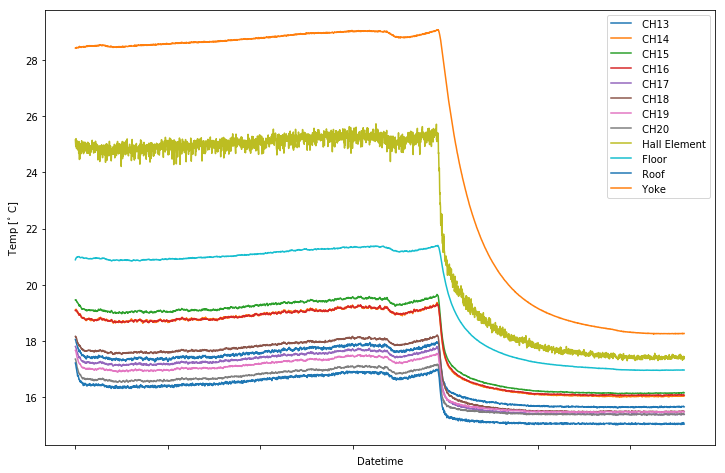

In [122]:
fig = plt.figure()
for c in temps_ch:
    df[c].plot()
#plt.ylabel('Temp [C]')
plt.ylabel("Temp [$^{\circ}$ C]")
plt.legend()    

In [123]:
fig = scatter2d([df.index for c in temps_ch],[df[c] for c in temps_ch],inline=True);
fig.layout.title = "Temp vs. Datetime"
fig.layout.yaxis.title = "Temp [deg. C]"

In [124]:
#fname = 'temps_scatter'
fname = 'temps_scatter_full'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-24/temps_scatter_full.html'

In [23]:
fig = scatter2d(df.index,df["CH21"],inline=True)

In [24]:
fig = scatter2d([df.index for c in temps_ch],[df[c]-(df[c].mean()-df[" Floor"].mean()) for c in temps_ch],inline=True);
fig.layout.title = "Temp vs. Datetime"
fig.layout.yaxis.title = "Temp [deg. C]"

In [30]:
fname = 'temps_scatter_adjusted'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-24/temps_scatter_adjusted.html'

In [25]:
fig = histo([df[c]-(df[c].mean()-df[" Floor"].mean()) for c in temps_ch],xlabel="Temperature (deg C)",verbosity=1,opacity=0.6,inline=True);
fig.layout.title = "Temp Histos"

In [32]:
fname = 'hist_temps_adjusted'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-24/hist_temps_adjusted.html'

In [26]:
fig = histo([df[c] for c in temps_ch],xlabel="Temperature (deg C)",verbosity=1,inline=True);
fig.layout.title = "Temp Histos"

In [34]:
fname = 'hist_temps'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-24/hist_temps.html'

In [27]:
fig = scatter2d(df.index,df[" Yoke"],inline=True);

In [36]:
fig = histo(df["CH21"],bins=50,inline=True);
pio.write_image(fig,plotdir+"hist_temp_Desk.pdf")
pio.write_image(fig,plotdir+"hist_temp_Desk.png")
fig = histo(df[" Floor"],bins=50,inline=True);
pio.write_image(fig,plotdir+"hist_temp_Floor.pdf")
pio.write_image(fig,plotdir+"hist_temp_Floor.png")

In [28]:
fig = histo(df[" Roof"],bins=50,inline=True);

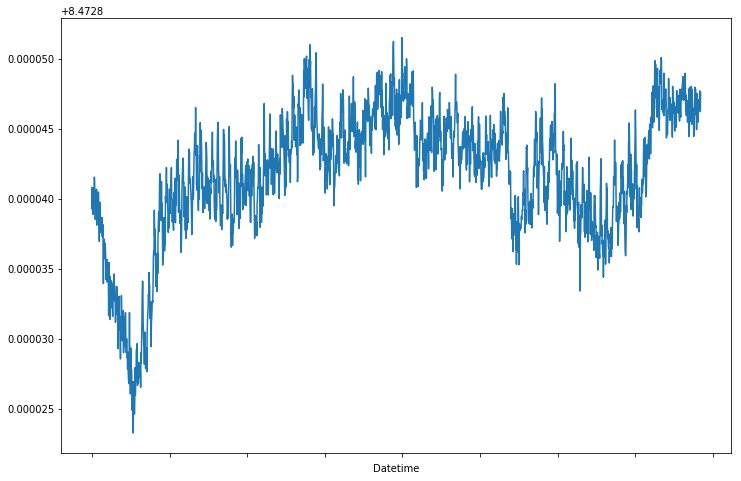

In [38]:
df[' Magnet Current [V]'].plot()

In [29]:
fig = scatter2d(df.index,df[' Magnet Current [V]'],inline=True);

In [40]:
fname = 'magnet_current'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-24/magnet_current.html'

In [30]:
fig = scatter2d(df.index,df[' Magnet Voltage [V]'],inline=True);

In [42]:
fname = 'magnet_voltage'
pio.write_image(fig, plotdir+fname+'.pdf')
pio.write_image(fig, plotdir+fname+'.png')
plot(fig, filename=plotdir+fname+'.html')

'file:///home/ckampa/Coding/hallprobecalib_extras/plots/magnet_stability/2019-06-24/magnet_voltage.html'

In [31]:
m =df[' Magnet Voltage [V]']
(m.max() - m.min()) / m.mean()

0.006771080452071135

In [44]:
for col in df.columns:
    fig = scatter2d(df.index,df[col],lines=True,markers=False,size_list=[6], show_plot=False,inline=True);
    pio.write_image(fig,plotdir+f"time_series/{col}.pdf")
    pio.write_image(fig,plotdir+f"time_series/{col}.png")

In [49]:
for col in df_full.columns:
    fig = scatter2d(df_full.index,df_full[col],lines=True,markers=False,size_list=[6], show_plot=False,inline=True);
    pio.write_image(fig,plotdir+f"time_series_full/{col}.pdf")
    pio.write_image(fig,plotdir+f"time_series_full/{col}.png")

## Correlations

- As seen in past dataset, NMR reading seems inversely correlated to the magnet voltage.
- It also appeared that the voltage was correlated to the water cooling system.
- Let's check if this relationship holds and also try to tease out other correlations.

In [32]:
import operator
from scipy import stats

In [47]:
ns = []
for col in df.columns:
    if (df[col].dtype == np.float64) & ("Zab" not in col) & ("NMR [FFT]" not in col) & (col != " "):
        ns.append(col)

In [48]:
len(df.columns)

52

In [49]:
len(ns)

43

In [50]:
df[ns].corr()

,Magnet Current [V],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,Hall Element,...,LCW to PS,LCW in barrel,ICW in,ICW HE1 out,ICW He2 out,LCW return magnet,LCW to barrel,LCW from PS,LCW to magnet,NMR [T]
Magnet Current [V],1.000000,0.503414,0.476481,0.490991,0.533296,0.530068,0.506210,0.521856,0.334014,0.272845,...,0.427241,0.418169,0.470064,0.485424,0.509843,0.408771,0.451485,0.527881,0.520030,-0.311233
Magnet Voltage [V],0.503414,1.000000,0.979311,0.983474,0.977529,0.982437,0.972785,0.988592,0.690694,0.562880,...,0.983070,0.979741,0.923129,0.939775,0.965026,0.958599,0.958532,0.968244,0.974138,-0.604774
Coil 1 (new),0.476481,0.979311,1.000000,0.970185,0.947568,0.953623,0.953529,0.963166,0.721669,0.572743,...,0.972921,0.969832,0.894685,0.912503,0.935793,0.951506,0.939964,0.945010,0.944949,-0.640078
Coil 2 (old),0.490991,0.983474,0.970185,1.000000,0.961952,0.967872,0.956003,0.974276,0.722899,0.614483,...,0.976312,0.972516,0.910125,0.924951,0.947585,0.954251,0.948514,0.951047,0.955927,-0.645627
LCW in Coil1,0.533296,0.977529,0.947568,0.961952,1.000000,0.999172,0.980744,0.996103,0.652817,0.550852,...,0.955162,0.949890,0.975572,0.982473,0.996197,0.911188,0.973045,0.941714,0.998121,-0.572618
LCW out Coil 1,0.530068,0.982437,0.953623,0.967872,0.999172,1.000000,0.980608,0.997509,0.660525,0.556953,...,0.961309,0.956283,0.971155,0.979100,0.994239,0.919975,0.973616,0.947209,0.997043,-0.579774
LCW in Coil 2,0.506210,0.972785,0.953529,0.956003,0.980744,0.980608,1.000000,0.983575,0.714717,0.572427,...,0.962974,0.957311,0.955124,0.963664,0.976626,0.924275,0.966837,0.934460,0.979372,-0.637603
LCW out Coil 2,0.521856,0.988592,0.963166,0.974276,0.996103,0.997509,0.983575,1.000000,0.683622,0.570915,...,0.971122,0.966297,0.963909,0.973812,0.989814,0.932560,0.974781,0.952056,0.993642,-0.602927
Yoke,0.334014,0.690694,0.721669,0.722899,0.652817,0.660525,0.714717,0.683622,1.000000,0.710120,...,0.754863,0.742821,0.632496,0.641981,0.641988,0.754443,0.700770,0.663352,0.645412,-0.990772
Hall Element,0.272845,0.562880,0.572743,0.614483,0.550852,0.556953,0.572427,0.570915,0.710120,1.000000,...,0.608934,0.601503,0.541147,0.543688,0.542295,0.604150,0.580697,0.539925,0.542699,-0.699979


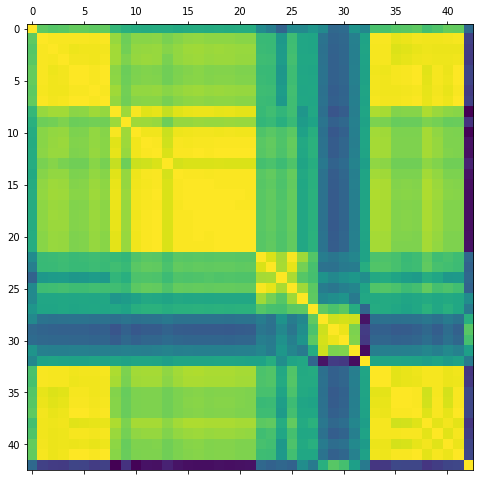

In [51]:
plt.matshow(df[ns].corr())

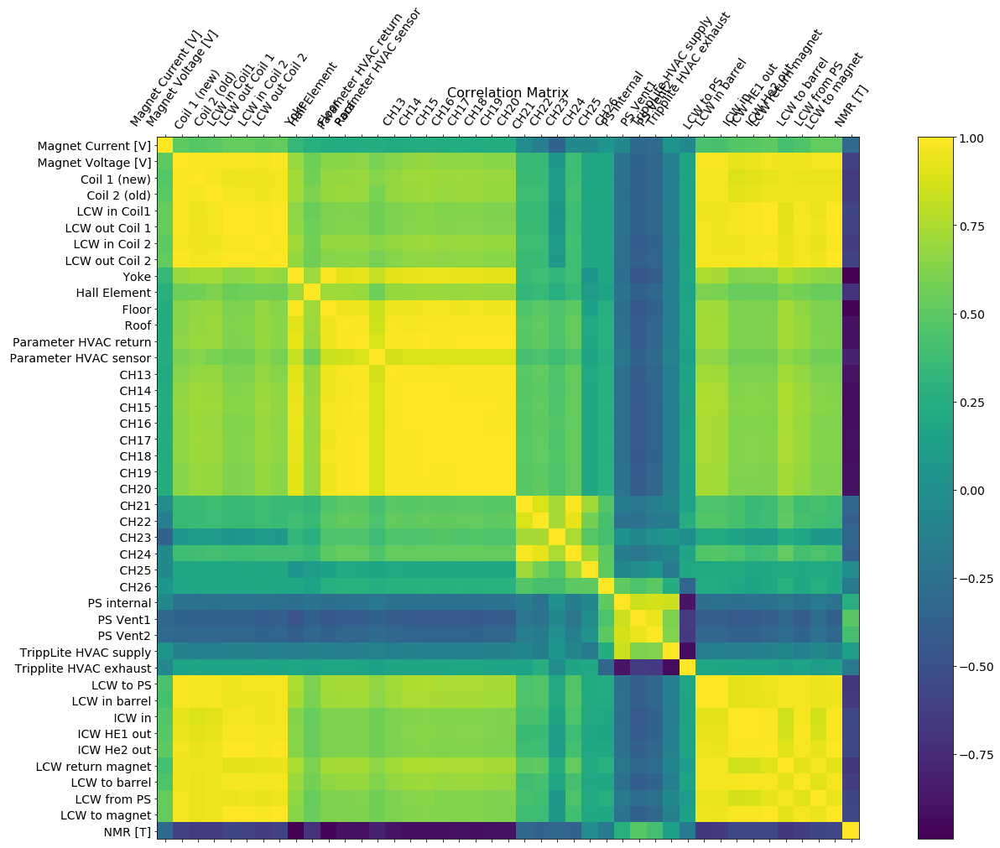

In [55]:
f = plt.figure(figsize=(25, 15))
plt.matshow(df[ns].corr(), fignum=f.number)
plt.xticks(range(df[ns].shape[1]), df[ns].columns, fontsize=14, rotation=55)
plt.yticks(range(df[ns].shape[1]), df[ns].columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

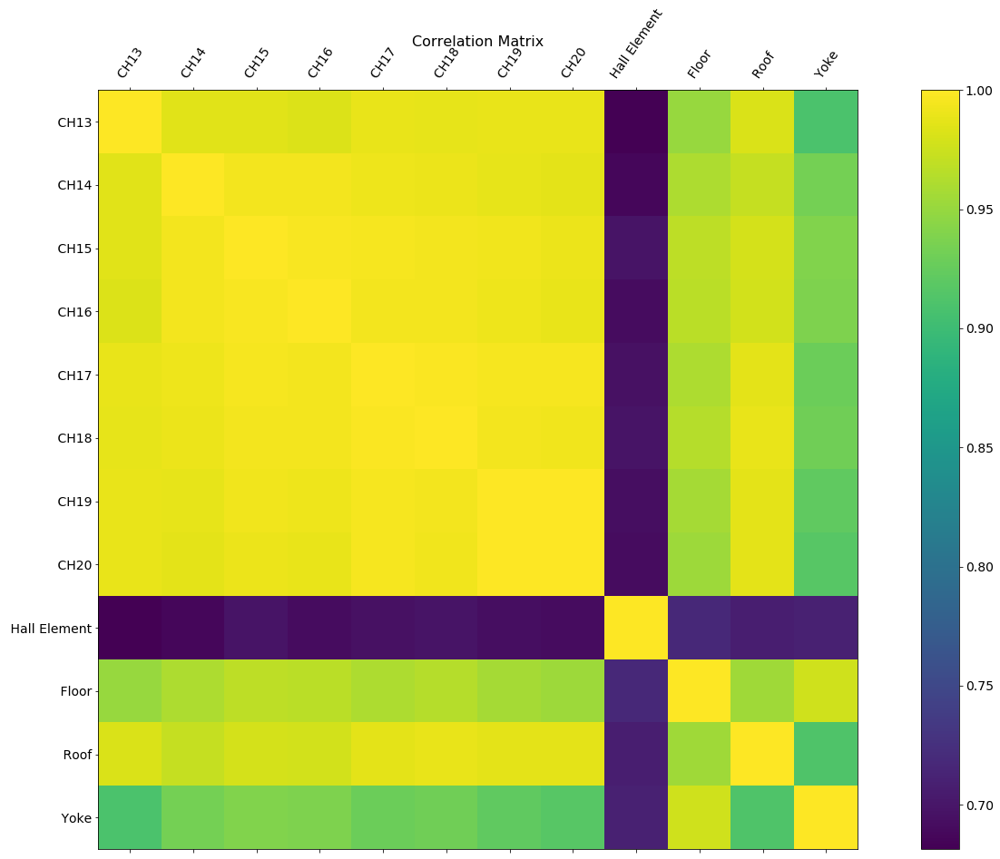

In [56]:
f = plt.figure(figsize=(25, 15))
plt.matshow(df[temps_ch].corr(), fignum=f.number)
plt.xticks(range(df[temps_ch].shape[1]), df[temps_ch].columns, fontsize=14, rotation=55)
plt.yticks(range(df[temps_ch].shape[1]), df[temps_ch].columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

In [63]:
#corr.style.background_gradient(cmap='coolwarm', axis=None)
#df.corr().style.background_gradient(cmap='coolwarm', axis=None)
df[ns].corr().style.background_gradient(cmap='coolwarm').set_precision(2)

In [64]:
primary_corr = dict()
for col in df.columns:
    if df[col].dtype == np.float64:
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[col], df[" NMR [T]"])
        #print(col,r_value_v,p_value_v,std_err_v)
        primary_corr[col] = r_value_v

sorted_primary_corr = sorted(primary_corr.items(), key=operator.itemgetter(1))

sorted_primary_corr

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:107: RuntimeWarning:

invalid value encountered in double_scalars

/home/ckampa/anaconda3/envs/Mu2E/lib/python3.7/site-packages/scipy/stats/_stats_mstats_common.py:119: RuntimeWarning:

divide by zero encountered in double_scalars



[(' Yoke', -0.9907719783018517),
 (' Floor', -0.9716525341520138),
 (' CH16', -0.9165862233597285),
 (' CH15', -0.9163597996376103),
 (' CH14', -0.9086648166605161),
 (' CH18', -0.9078635175263853),
 (' CH17', -0.9041227336338774),
 ('Parameter HVAC return', -0.9026507582787837),
 (' CH19', -0.8993905777930363),
 (' CH20', -0.8939697986981511),
 (' Roof', -0.8911435115020341),
 (' CH13', -0.8859717156492459),
 (' Parameter HVAC sensor', -0.7992662411382752),
 (' Hall Element', -0.6999788093304589),
 ('LCW to PS', -0.6762516587154873),
 (' LCW return magnet', -0.6752658459452745),
 (' LCW in barrel', -0.6634005599756533),
 (' Coil 2 (old)', -0.6456266899663595),
 ('Coil 1 (new)', -0.6400784120893738),
 (' LCW in Coil 2', -0.6376034737455822),
 (' LCW to barrel', -0.6259444705099295),
 (' Magnet Voltage [V]', -0.6047742494814207),
 (' LCW out Coil 2', -0.602927107819414),
 (' LCW out Coil 1', -0.5797742952171104),
 (' LCW from PS', -0.5774750175810437),
 (' LCW in Coil1', -0.572618167637

Would be helpful to see time as the color to see how this is traced out.

In [65]:
df['ind'] = np.array([i for i in range(len(df))])

In [66]:
def color_scatter2d(x,y,ind,time=df.index,show_plot=True):
    data = [
        go.Scatter(
            x=x,
            y=y,
            marker=dict(
                size=2,
                cmax=ind.max(),
                cmin=ind.min(),
                color=ind,
                colorbar=dict(
                    title='time (index)',
                    #ticktext=df.index
                ),
                colorscale='Viridis',
            ),
            mode='markers',
            text=time,
        )
    ]
    
    layout = go.Layout(
        title = f"{y.name} vs. {x.name}",
        xaxis = dict(
            title = f"{x.name}"
        ),
        yaxis = dict(
            title = f"{y.name}"
        ),
    )

    fig = go.Figure(data=data,layout=layout)
    if show_plot:
        iplot(fig)
    return fig

In [54]:
for col in df.columns:
    fig = color_scatter2d(df[col],df[" NMR [T]"],df.ind,show_plot=False);
    pio.write_image(fig,plotdir+f"nmr_correlations/{col}_vs_nmr.pdf")
    pio.write_image(fig,plotdir+f"nmr_correlations/{col}_vs_nmr.png")

In [69]:
df_back = df

In [106]:
df = df_back

In [82]:
df_ = df[df.ind < 1600]

In [107]:
fig = color_scatter2d(df[" Yoke"],df[" NMR [T]"],df.ind,show_plot=True);

In [83]:
df = df_

In [108]:
#corr_main = " LCW in barrel"
corr_main = " Yoke"
#slope, intercept, r_value, p_value, std_err = stats.linregress(df[" Yoke"], df[" NMR [T]"])
slope, intercept, r_value, p_value, std_err = stats.linregress(df[corr_main], df[" NMR [T]"])

In [109]:
slope, intercept, r_value, p_value, std_err

(-0.00015219904462217726,
 1.3229904452532273,
 -0.9907719783018517,
 0.0,
 4.704203018936812e-07)

In [110]:
line = slope * df[corr_main] + intercept

In [111]:
fig = scatter2d(2*[df[corr_main]],[df[" NMR [T]"],line],lines=False,markers=True,size_list=[2,2],inline=True)

In [112]:
pio.write_image(fig,plotdir+f"yoke_vs_nmr_fit.pdf")
pio.write_image(fig,plotdir+f"yoke_vs_nmr_fit.png")

In [113]:
df["NMR_const"] = df[" NMR [T]"] - slope * df[corr_main] - intercept + df[" NMR [T]"].mean()

In [114]:
fig = scatter2d(2*[df[corr_main]],[df["NMR_const"],line],lines=False,markers=True,size_list=[2,2],inline=True)

In [115]:
pio.write_image(fig,plotdir+f"yoke_vs_nmr_fit_subtract.pdf")
pio.write_image(fig,plotdir+f"yoke_vs_nmr_fit_subtract.png")

In [117]:
fig = histo(df[" NMR [T]"],bins=50,inline=True);
pio.write_image(fig,plotdir+f"hist_NMR.pdf")
pio.write_image(fig,plotdir+f"hist_NMR.png")
fig = histo(df["NMR_const"],bins=50,inline=True);
pio.write_image(fig,plotdir+f"yoke_correction_nmr_hist.pdf")
pio.write_image(fig,plotdir+f"yoke_correction_nmr_hist.png")

This looks nice. Let's try to remake the correlation plots on NMR_const.

In [94]:
secondary_corr = dict()
for col in df.columns:
    if df[col].dtype == np.float64:
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[col], df["NMR_const"])
        #print(col,r_value_v,p_value_v,std_err_v)
        secondary_corr[col] = r_value_v

sorted_corr = sorted(secondary_corr.items(), key=operator.itemgetter(1))

sorted_corr

[(' Hall Element', -0.029647119716996517),
 (' TrippLite HVAC supply', -0.0040729098216274705),
 (' NMR [FFT]', 0.0),
 (' Zaber_Meas_MicroStep_X', 0.0),
 (' Zaber_Meas_Encoder_X', 0.0),
 ('  Zaber_Meas_MicroStep_Y', 0.0),
 (' Zaber_Meas_Encoder_Y', 0.0),
 ('  Zaber_Meas_MicroStep_Z', 0.0),
 (' Zaber_Meas_Encoder_Z', 0.0),
 (' Yoke', 9.848053852481595e-14),
 (' Tripplite HVAC exhaust', 0.04366880434638592),
 (' PS internal', 0.0441463269765882),
 (' Floor', 0.04922515364020694),
 (' Magnet Current [V]', 0.059483934451136714),
 (' NMR [T]', 0.0809985152101691),
 (' CH23', 0.11810031271433458),
 (' PS Vent1', 0.12635249479895266),
 (' PS Vent2', 0.1436464927868475),
 (' LCW to barrel', 0.14504166957436812),
 (' ICW HE1 out', 0.14765651982985242),
 (' Coil 2 (old)', 0.15169459134637922),
 (' CH16', 0.1749906749587908),
 (' ICW in', 0.1757690602688552),
 (' LCW out Coil 1', 0.18181828785072005),
 (' LCW in Coil1', 0.18218225212647504),
 (' LCW out Coil 2', 0.18224187955113413),
 (' CH15', 0

In [65]:
for col in df.columns:
    fig = color_scatter2d(df[col],df["NMR_const"],df.ind,show_plot=False);
    pio.write_image(fig,plotdir+f"nmr_const_correlations/{col}_vs_nmr.pdf")
    pio.write_image(fig,plotdir+f"nmr_const_correlations/{col}_vs_nmr.png")

The water temperature or maybe magnet voltage seem correlated now, except for a weird bit at the end. So we do a similar fit and subtract based on data with a time cut.

In [66]:
#fit_var = "Coil 1 (new)"
#fit_var = " ICW He2 out"
#fit_var = " CH15"
#fit_var = " Magnet Current [V]"
fit_var = " LCW from PS"
fig = color_scatter2d(df[fit_var],df["NMR_const"],df.ind,show_plot=True);

In [67]:
#fit_var = " Magnet Voltage [V]"
#t = df.ind < 3400
t = df.ind > 1500
fig = color_scatter2d(df[t][fit_var],df[t]["NMR_const"],df.ind,show_plot=True);

In [68]:
slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[t][fit_var], df[t]["NMR_const"])

In [69]:
slope_v, intercept_v, r_value_v, p_value_v, std_err_v

(1.530001017519958e-05,
 1.318143537285563,
 0.9492378468936211,
 3.479419495929382e-232,
 2.369116241142229e-07)

In [70]:
line_v = slope_v * df[fit_var] + intercept_v

In [71]:
fig = scatter2d(2*[df[fit_var]],[df["NMR_const"],line_v],lines=False,markers=True,size_list=[2,2],inline=True)

In [82]:
[row.NMR_const if (row.ind <= 1500) else (row.NMR_const-slope_v*row[fit_var]-intercept_v+df["NMR_const"].mean()) for row in df.iterrows()]

AttributeError: 'tuple' object has no attribute 'ind'

In [142]:
df["NMR_const_v"] = df["NMR_const"] - slope_v * df[fit_var] - intercept_v + df["NMR_const"].mean()

In [143]:
fig = scatter2d(2*[df[fit_var]],[df["NMR_const_v"],line_v],lines=False,markers=True,size_list=[2,2],inline=True)

In [144]:
fig = scatter2d(2*[df[" Yoke"]],[df["NMR_const"],df["NMR_const_v"]],lines=False,markers=True,size_list=[2,2],inline=True)

In [145]:
histo(df[" NMR [T]"],bins=50,inline=True);
histo(df["NMR_const"],bins=50,inline=True);
histo(df["NMR_const_v"],bins=50,inline=True);

In [146]:
fig = scatter2d(df.index,df["NMR_const_v"],lines=False,markers=True,inline=True)

In [147]:
fig = scatter2d(df[" Yoke"],df["NMR_const_v"],lines=False,markers=True,inline=True)

In [120]:
slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[fit_var], df["NMR_const"])

In [121]:
slope_v, intercept_v, r_value_v, p_value_v, std_err_v

(0.012201686510950032,
 1.215232109827265,
 0.38479939589951706,
 1.587551471867713e-40,
 0.0008788636806723389)

In [122]:
line_v = slope_v * df[fit_var] + intercept_v

In [133]:
fig = scatter2d(2*[df[fit_var]],[df["NMR_const"],line_v],lines=False,markers=True,size_list=[2,2],inline=True)

In [134]:
pio.write_image(fig,plotdir+'current_vs_nmr_corr.pdf')
pio.write_image(fig,plotdir+'current_vs_nmr_corr.png')

In [124]:
df["NMR_const_v"] = df["NMR_const"] - slope_v * df[fit_var] - intercept_v + df["NMR_const"].mean()

In [125]:
fig = scatter2d(2*[df[fit_var]],[df["NMR_const_v"],line_v],lines=False,markers=True,size_list=[2,2],inline=True)

In [127]:
fig = scatter2d(2*[df[" Yoke"]],[df["NMR_const"],df["NMR_const_v"]],lines=False,markers=True,size_list=[2,2],inline=True)

In [132]:
histo(df[" NMR [T]"],bins=50,inline=True);
histo(df["NMR_const"],bins=50,inline=True);
fig = histo(df["NMR_const_v"],bins=50,inline=True);
pio.write_image(fig,plotdir+'hist_lcw_and_current_nmr.pdf')
pio.write_image(fig,plotdir+'hist_lcw_and_current_nmr.png')

In [129]:
fig = scatter2d(df.index,df["NMR_const_v"],lines=False,markers=True,inline=True)

In [130]:
secondary_corr = dict()
for col in df.columns:
    if df[col].dtype == np.float64:
        slope_v, intercept_v, r_value_v, p_value_v, std_err_v = stats.linregress(df[col], df["NMR_const"])
        #print(col,r_value_v,p_value_v,std_err_v)
        secondary_corr[col] = r_value_v

sorted_corr = sorted(secondary_corr.items(), key=operator.itemgetter(1))

sorted_corr

[('CH21', -0.3885534646580409),
 (' PS internal', -0.35708653432636306),
 (' CH24', -0.3342385171995513),
 (' TrippLite HVAC supply', -0.3342153711992046),
 (' Tripplite HVAC exhaust', -0.3184286567926354),
 (' LCW return magnet', -0.3092980238619549),
 (' PS Vent1', -0.2880953495470907),
 (' CH23', -0.28127414245906424),
 (' CH26', -0.26926788942395785),
 (' PS Vent2', -0.23226815002473722),
 (' CH25', -0.20155589368342575),
 (' Floor', -0.18120676123362264),
 (' CH22', -0.18097757808333576),
 (' CH19', -0.16038782244760563),
 ('Parameter HVAC return', -0.1407857450572583),
 (' CH16', -0.13848643411811268),
 (' CH20', -0.12873344800184316),
 (' CH17', -0.08636742383956462),
 (' CH15', -0.0715346870247601),
 (' Hall Element', -0.07146851143024217),
 (' CH18', -0.07073819227352984),
 (' Roof', -0.06602205117202375),
 (' CH13', -0.061391518532199894),
 (' Yoke', -0.04546128697931081),
 (' CH14', -0.043426614329115425),
 ('LCW to PS', -0.015195553970804203),
 (' Parameter HVAC sensor', -0

## Slope of changes

In [116]:
df.drop([" "],axis=1,inplace=True)

In [117]:
df.columns

Index(['Time', ' Magnet Current [V]', ' Magnet Voltage [V]', 'Coil 1 (new)',
       ' Coil 2 (old)', ' LCW in Coil1', ' LCW out Coil 1', ' LCW in Coil 2',
       ' LCW out Coil 2', ' Yoke', ' Hall Element', ' Floor', ' Roof',
       'Parameter HVAC return', ' Parameter HVAC sensor', ' CH13', ' CH14',
       ' CH15', ' CH16', ' CH17', ' CH18', ' CH19', ' CH20', 'CH21', ' CH22',
       ' CH23', ' CH24', ' CH25', ' CH26', ' PS internal', ' PS Vent1',
       ' PS Vent2', ' TrippLite HVAC supply', ' Tripplite HVAC exhaust',
       'LCW to PS', ' LCW in barrel', ' ICW in', ' ICW HE1 out',
       ' ICW He2 out', ' LCW return magnet', ' LCW to barrel', ' LCW from PS',
       'LCW to magnet', ' NMR [T]', ' NMR [FFT]', ' Zaber_Meas_MicroStep_X',
       ' Zaber_Meas_Encoder_X', '  Zaber_Meas_MicroStep_Y',
       ' Zaber_Meas_Encoder_Y', '  Zaber_Meas_MicroStep_Z',
       ' Zaber_Meas_Encoder_Z', 'ind', 'NMR_const', 'NMR_const_v'],
      dtype='object')

In [118]:
col_float = [col for col in df.columns if df[col].dtype == np.float64]

In [119]:
col_float

[' Magnet Current [V]',
 ' Magnet Voltage [V]',
 'Coil 1 (new)',
 ' Coil 2 (old)',
 ' LCW in Coil1',
 ' LCW out Coil 1',
 ' LCW in Coil 2',
 ' LCW out Coil 2',
 ' Yoke',
 ' Hall Element',
 ' Floor',
 ' Roof',
 'Parameter HVAC return',
 ' Parameter HVAC sensor',
 ' CH13',
 ' CH14',
 ' CH15',
 ' CH16',
 ' CH17',
 ' CH18',
 ' CH19',
 ' CH20',
 'CH21',
 ' CH22',
 ' CH23',
 ' CH24',
 ' CH25',
 ' CH26',
 ' PS internal',
 ' PS Vent1',
 ' PS Vent2',
 ' TrippLite HVAC supply',
 ' Tripplite HVAC exhaust',
 'LCW to PS',
 ' LCW in barrel',
 ' ICW in',
 ' ICW HE1 out',
 ' ICW He2 out',
 ' LCW return magnet',
 ' LCW to barrel',
 ' LCW from PS',
 'LCW to magnet',
 ' NMR [T]',
 ' NMR [FFT]',
 ' Zaber_Meas_MicroStep_X',
 ' Zaber_Meas_Encoder_X',
 '  Zaber_Meas_MicroStep_Y',
 ' Zaber_Meas_Encoder_Y',
 '  Zaber_Meas_MicroStep_Z',
 ' Zaber_Meas_Encoder_Z',
 'NMR_const',
 'NMR_const_v']

In [120]:
#temp = df[' Yoke']

In [121]:
slopes = df[col_float].apply(lambda x: np.polyfit(df.ind, x, 1)[0])

In [122]:
slopes

 Magnet Current [V]        -1.645282e-08
 Magnet Voltage [V]        -1.555289e-05
Coil 1 (new)               -9.534695e-05
 Coil 2 (old)              -7.860980e-05
 LCW in Coil1              -1.190017e-04
 LCW out Coil 1            -1.182661e-04
 LCW in Coil 2             -1.099698e-04
 LCW out Coil 2            -1.132179e-04
 Yoke                      -7.516065e-05
 Hall Element              -1.686016e-05
 Floor                     -8.048303e-05
 Roof                      -7.165264e-05
Parameter HVAC return      -7.776762e-05
 Parameter HVAC sensor     -7.320478e-05
 CH13                      -8.866880e-05
 CH14                      -9.465698e-05
 CH15                      -9.998848e-05
 CH16                      -8.932704e-05
 CH17                      -8.662483e-05
 CH18                      -8.548355e-05
 CH19                      -8.446150e-05
 CH20                      -7.921378e-05
CH21                       -1.124420e-04
 CH22                      -4.523067e-05
 CH23           

In [53]:
[df[" NMR [T]"][i+1] - row[" NMR [T]"] for i,row in enumerate(df.itertuples())]

TypeError: tuple indices must be integers or slices, not str

In [123]:
t_outside = df["CH21"].values
t_inside = df[" Yoke"].values
t_inside2 = df[" Floor"].values

In [124]:
slope_inside = [t_inside[i+1]-t_inside[i] for i in range(len(t_inside)-1)]
slope_inside.append(0)
slope_inside = pd.Series(slope_inside,name="Inside Temp Change: Yoke")
slope_inside2 = [t_inside[i+1]-t_inside[i] for i in range(len(t_inside)-1)]
slope_inside2.append(0)
slope_inside2 = pd.Series(slope_inside2,name="Inside Temp Change: Floor")

In [125]:
fig = scatter2d(df.index,slope_inside,inline=True);

In [126]:
pio.write_image(fig, plotdir+"temp_change_Yoke.pdf")
pio.write_image(fig, plotdir+"temp_change_Yoke.png")

In [127]:
fig = scatter2d(df.index,slope_inside2,inline=True);

In [128]:
pio.write_image(fig, plotdir+"temp_change_Floor.pdf")
pio.write_image(fig, plotdir+"temp_change_Floor.png")

In [129]:
slope_outside = [t_outside[i+1]-t_outside[i] for i in range(len(t_outside)-1)]
slope_outside.append(0)
slope_outside = pd.Series(slope_outside,name="Outside Temp Change")

In [130]:
fig = scatter2d(df.index,slope_outside,inline=True);

In [131]:
pio.write_image(fig, plotdir+"temp_change_Desk.pdf")
pio.write_image(fig, plotdir+"temp_change_Desk.png")

In [132]:
fig = histo(slope_inside,bins=50,xlabel="Temp Change (deg / min)",inline=True);
pio.write_image(fig, plotdir+"hist_temp_change_Yoke.pdf")
pio.write_image(fig, plotdir+"hist_temp_change_Yoke.png")
fig = histo(slope_inside2,bins=50,xlabel="Temp Change (deg / min)",inline=True);
pio.write_image(fig, plotdir+"hist_temp_change_Floor.pdf")
pio.write_image(fig, plotdir+"hist_temp_change_Floor.png")
fig = histo(slope_outside,bins=50,xlabel="Temp Change (deg / min)",inline=True);
pio.write_image(fig, plotdir+"hist_temp_change_Desk.pdf")
pio.write_image(fig, plotdir+"hist_temp_change_Desk.png")

In [ ]:
-1.8e-4 * 